# Cluster and Visualize Unlabeled Acoustic Embeddings

This notebook:
1. Loads the 1536-dim Perch embeddings
2. Reduces to 3D with UMAP (full) and t-SNE (subset) for visualization
3. Clusters with K-means (~50 -> 25 clusters, flexible)
4. Samples 100 audio files per cluster (20 nearest + 20 farthest + 60 random)
5. Creates interactive 3D plots and saves results for review
6. Saves audios to Review folder (**folders number = cluster num + 1**)

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from pathlib import Path
import os
from os import environ

import umap
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from tqdm import tqdm
from mpl_toolkits.mplot3d import Axes3D

import librosa
import librosa.display
from IPython.display import Audio, display

%matplotlib inline

/home/gladys/anaconda3/envs/tf_gpu/lib/python3.9/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
2026-01-19 10:33:03.714221: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2026-01-19 10:33:03.752820: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2026-01-19 10:33:04.712935: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly

## 1. Load Embeddings and Manifest

In [2]:
env_dir = environ.get("POSIDONIA_DATASET_DIR")
DATASET_DIR = Path(env_dir) if env_dir else Path("/mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset")

# Load embeddings and manifest (minimal)
EMBEDDINGS_PATH = DATASET_DIR / "npy_files" / "unlabeled_embeddings.npy"
MANIFEST_PATH = DATASET_DIR / "unlabeled_manifest.csv"

embeddings = np.load(str(EMBEDDINGS_PATH))
manifest_df = pd.read_csv(str(MANIFEST_PATH))

print(f"Loaded {embeddings.shape[0]} embeddings of dimension {embeddings.shape[1]}")
print(f"Manifest has {len(manifest_df)} rows")
manifest_df.head()


Loaded 392400 embeddings of dimension 1536
Manifest has 392400 rows


,original_audio,embedding_path,segment_path,audio_path,file_name,embedding_dim
0,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,NaN,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,channelA_2025-05-16_14-00-03.wav,1536
1,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,NaN,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,channelA_2025-05-16_14-00-08.wav,1536
2,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,NaN,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,channelA_2025-05-16_14-00-13.wav,1536
3,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,NaN,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,channelA_2025-05-16_14-00-18.wav,1536
4,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,NaN,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,channelA_2025-05-16_14-00-23.wav,1536


## 2. Dimensionality Reduction: UMAP and t-SNE to 3D

Reduce 1536 → 3D for visualization and clustering.

In [3]:
# Check if output files already exist
output_dir = Path(EMBEDDINGS_PATH).parent
umap_file = output_dir / "umap_embeddings.npy"
tsne_file = output_dir / "tsne_subset_embeddings.npy"
tsne_idx_file = output_dir / "tsne_subset_indices.npy"

if umap_file.exists() and tsne_file.exists() and tsne_idx_file.exists():
    print("Loading pre-computed UMAP and t-SNE embeddings...")
    umap_results = np.load(str(umap_file))
    tsne_results = np.load(str(tsne_file))
    tsne_idx = np.load(str(tsne_idx_file))
    print(f"Loaded UMAP: {umap_results.shape}")
    print(f"Loaded t-SNE subset: {tsne_results.shape}")
    print(f"Loaded t-SNE subset indices: {tsne_idx.shape}")
else:
    print("Pre-reducing to 256D with PCA to avoid UMAP memory crash...") # PCA pre-reduction because dataset is
    from sklearn.decomposition import PCA
    embeddings_fp32 = embeddings.astype(np.float32, copy=False)
    pca_256 = PCA(n_components=256, random_state=42)
    embeddings_pca_256 = pca_256.fit_transform(embeddings_fp32)
    print(f"PCA done! Reduced {embeddings.shape[1]}D → 256D")

    print("\nRunning UMAP on 256D embeddings (this may take 3-5 minutes)...")
    umap_model = umap.UMAP(n_components=3, random_state=42, n_neighbors=15, min_dist=0.1, low_memory=True, metric='euclidean')
    umap_results = umap_model.fit_transform(embeddings_pca_256)
    print("UMAP done!")

    print("\nRunning t-SNE for 3D visualization on a subset (to avoid crashes)...")
    # Run t-SNE on a subset to prevent memory issues
    TSNE_VIS_LIMIT = 50000
    rng = np.random.default_rng(42)
    tsne_idx = rng.choice(embeddings.shape[0], size=min(TSNE_VIS_LIMIT, embeddings.shape[0]), replace=False)

    tsne = TSNE(n_components=3, random_state=42, perplexity=30)
    tsne_results = tsne.fit_transform(embeddings_pca_256[tsne_idx])
    print("t-SNE subset done!")

    # Save reduced embeddings
    output_dir.mkdir(parents=True, exist_ok=True)
    np.save(str(umap_file), umap_results)
    np.save(str(tsne_file), tsne_results)
    np.save(str(tsne_idx_file), tsne_idx)
    print(f"\nSaved UMAP to: {umap_file}")
    print(f"Saved t-SNE subset to: {tsne_file}")
    print(f"Saved t-SNE subset indices to: {tsne_idx_file}")

# Add UMAP to manifest (full)
manifest_df['umap_x'] = umap_results[:, 0]
manifest_df['umap_y'] = umap_results[:, 1]
manifest_df['umap_z'] = umap_results[:, 2]

# Add t-SNE to manifest for subset rows only, others will be NaN
manifest_df['tsne_x'] = np.nan
manifest_df['tsne_y'] = np.nan
manifest_df['tsne_z'] = np.nan
manifest_df.loc[tsne_idx, 'tsne_x'] = tsne_results[:, 0]
manifest_df.loc[tsne_idx, 'tsne_y'] = tsne_results[:, 1]
manifest_df.loc[tsne_idx, 'tsne_z'] = tsne_results[:, 2]

print("\nUMAP and t-SNE embeddings added to manifest.")

Loading pre-computed UMAP and t-SNE embeddings...
Loaded UMAP: (392400, 3)
Loaded t-SNE subset: (50000, 3)
Loaded t-SNE subset indices: (50000,)

UMAP and t-SNE embeddings added to manifest.


## 2.1 Computing optimal K with Solhouette Score Analysis

In [4]:
# # finding optimal k with Silhouette score analysis
# from find_optimal_k import find_optimal_k

# # Find optimal k for UMAP embeddings
# results = find_optimal_k(umap_results, k_range=(5, 81, 5), visualize=True, verbose=True)

# optimal_k = results['optimal_k']  # Use this in section 3
# best_model = results['kmeans_model']  # Can reuse the fitted model
# print (optimal_k)
# print (best_model)

## 3. K-means Clustering on UMAP

Cluster the 3D UMAP embeddings with K-means (flexible k, start with ~50 -> 25 ).

In [5]:
# Set number of clusters
k = 25  # Change this to 10, 15, 20, or 25

output_dir = Path(EMBEDDINGS_PATH).parent
umap_labels_file = output_dir / f"umap_kmeans_labels_k{k}.npy"

if umap_labels_file.exists():
    print(f"Loading pre-computed UMAP K-means clustering (k={k})...")
    umap_labels = np.load(str(umap_labels_file))
    kmeans_umap = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans_umap.fit(umap_results)  # Just to set centroids
    kmeans_umap.labels_ = umap_labels
    centroids_umap = kmeans_umap.cluster_centers_
else:
    print(f"Running K-means clustering with k={k} on UMAP embeddings...")
    kmeans_umap = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans_umap.fit(umap_results)
    centroids_umap = kmeans_umap.cluster_centers_
    np.save(str(umap_labels_file), kmeans_umap.labels_)
    print(f"Saved clustering results to: {umap_labels_file}")

manifest_df['umap_cluster'] = kmeans_umap.labels_

print(f"Clustering done! Found {k} clusters")
print(f"\nCluster sizes:")
print(manifest_df['umap_cluster'].value_counts().sort_index())

Loading pre-computed UMAP K-means clustering (k=25)...
Clustering done! Found 25 clusters

Cluster sizes:
umap_cluster
0     17903
1     17658
2     20062
3     18944
4     25921
5     12852
6     18305
7     19857
8     15111
9     14588
10    14020
11    26101
12    18161
13     5886
14    19543
15    18117
16    15831
17    10508
18    22214
19    10751
20      227
21      328
22    12958
23    14245
24    22309
Name: count, dtype: int64


## 4. K-means Clustering on t-SNE

Cluster the 3D t-SNE embeddings with K-means.

In [6]:
print(f"Running K-means clustering with k={k} on t-SNE subset embeddings...")
# Cluster only the t-SNE subset for visualization purposes
tsne_labels_file = output_dir / f"tsne_subset_kmeans_labels_k{k}.npy"

if tsne_labels_file.exists():
    print(f"Loading pre-computed t-SNE K-means clustering (k={k})...")
    tsne_labels = np.load(str(tsne_labels_file))
    kmeans_tsne = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans_tsne.fit(tsne_results)  # Just to set centroids
    kmeans_tsne.labels_ = tsne_labels
    centroids_tsne = kmeans_tsne.cluster_centers_
else:
    kmeans_tsne = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans_tsne.fit(tsne_results)
    centroids_tsne = kmeans_tsne.cluster_centers_
    np.save(str(tsne_labels_file), kmeans_tsne.labels_)
    print(f"Saved clustering results to: {tsne_labels_file}")

# Assign labels to manifest for subset rows; others remain NaN
manifest_df['tsne_cluster'] = np.nan
manifest_df.loc[tsne_idx, 'tsne_cluster'] = kmeans_tsne.labels_

print(f"Clustering done! Found {k} clusters on t-SNE subset")
print(f"\nCluster sizes (subset only):")
print(pd.Series(kmeans_tsne.labels_).value_counts().sort_index())

Running K-means clustering with k=25 on t-SNE subset embeddings...
Loading pre-computed t-SNE K-means clustering (k=25)...
Clustering done! Found 25 clusters on t-SNE subset

Cluster sizes (subset only):
0     2225
1     1950
2     2030
3     1936
4     2066
5     1995
6     2619
7     2122
8     1869
9     2198
10    2011
11    1862
12    1854
13    1768
14    2061
15    2270
16    1952
17    2090
18    2133
19    1879
20    2219
21    2029
22    1618
23    1885
24    1359
Name: count, dtype: int64


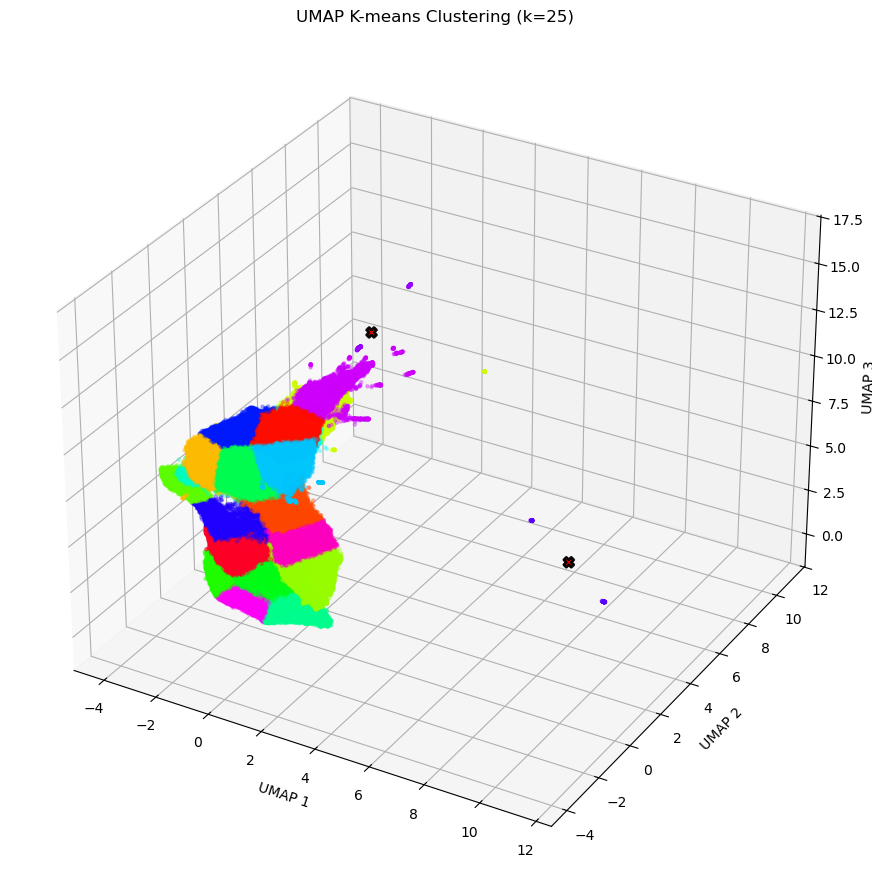

In [7]:
# Plot UMAP clusters in 3D
fig = plt.figure(figsize=(12, 9))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(umap_results[:, 0], umap_results[:, 1], umap_results[:, 2], 
                     c=kmeans_umap.labels_, cmap='gist_rainbow', s=5, alpha=0.3)
ax.scatter(centroids_umap[:, 0], centroids_umap[:, 1], centroids_umap[:, 2], 
           c='red', s=50, marker='X', edgecolors='black', linewidths=2)
ax.set_title(f'UMAP K-means Clustering (k={k})')
ax.set_xlabel('UMAP 1')
ax.set_ylabel('UMAP 2')
ax.set_zlabel('UMAP 3')
plt.tight_layout()
plt.show()

## 5. Visualize t-SNE Clusters

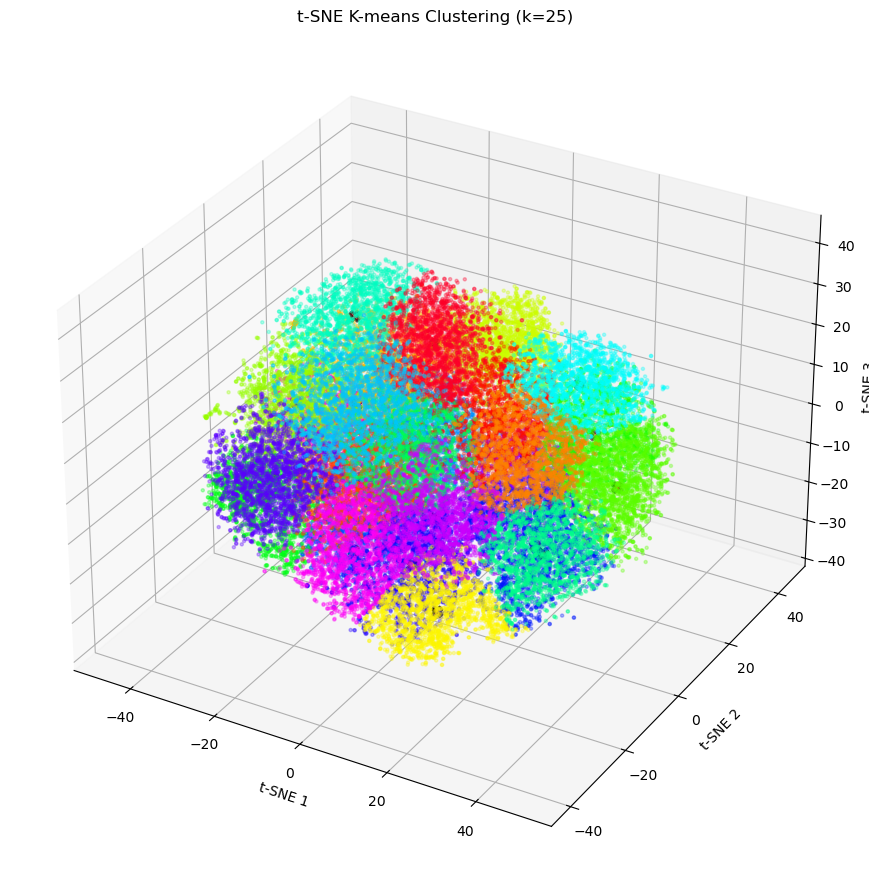

In [8]:
# Plot t-SNE clusters in 3D
fig = plt.figure(figsize=(12, 9))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(tsne_results[:, 0], tsne_results[:, 1], tsne_results[:, 2], 
                     c=kmeans_tsne.labels_, cmap='gist_rainbow', s=5, alpha=0.3)
ax.scatter(centroids_tsne[:, 0], centroids_tsne[:, 1], centroids_tsne[:, 2], 
           c='red', s=50, marker='X', edgecolors='black', linewidths=2)
ax.set_title(f't-SNE K-means Clustering (k={k})')
ax.set_xlabel('t-SNE 1')
ax.set_ylabel('t-SNE 2')
ax.set_zlabel('t-SNE 3')
plt.tight_layout()
plt.show()

## 6. Sample Strategy: 20 nearest + 20 farthest + 60 random per cluster

For each cluster, select 100 audio samples for review.

In [9]:
def sample_cluster(cluster_indices, cluster_embeddings, centroid, n_nearest=20, n_farthest=20, n_random=60):
    """
    Sample from a cluster: nearest, farthest, and random points.
    """
    # Compute distances to centroid
    dists = np.linalg.norm(cluster_embeddings - centroid, axis=1)

    # Get nearest and farthest indices
    order = np.argsort(dists)
    nearest_idx = cluster_indices[order[:n_nearest]]
    farthest_idx = cluster_indices[order[-n_farthest:]]

    # Get remaining indices for random sampling
    remaining_idx = np.setdiff1d(cluster_indices, np.concatenate([nearest_idx, farthest_idx]))

    if len(remaining_idx) > n_random:
        rng = np.random.default_rng(42)
        random_idx = rng.choice(remaining_idx, size=n_random, replace=False)
    else:
        random_idx = remaining_idx

    # Combine all indices
    sampled_idx = np.concatenate([nearest_idx, farthest_idx, random_idx])
    return np.unique(sampled_idx)

# Check if sampling results already exist
umap_csv = output_dir / "subsample_umap_kmeans.csv"
tsne_csv = output_dir / "subsample_tsne_kmeans.csv"

if umap_csv.exists() and tsne_csv.exists():
    print("Loading pre-computed sample indices...")
    umap_subsample_df = pd.read_csv(str(umap_csv))
    tsne_subsample_df = pd.read_csv(str(tsne_csv))
    umap_subsample_indices = umap_subsample_df['reduced_embeddings_idx'].values
    tsne_subsample_indices = tsne_subsample_df['reduced_embeddings_idx'].values
    print(f"Loaded {len(umap_subsample_indices)} UMAP samples")
    print(f"Loaded {len(tsne_subsample_indices)} t-SNE samples")
else:
    # Sample from UMAP clusters (full set)
    print("Sampling from UMAP clusters...")
    umap_subsample_indices = []
    for i in tqdm(range(k)):
        cluster_indices = np.where(kmeans_umap.labels_ == i)[0]
        cluster_embeddings = umap_results[cluster_indices]
        centroid = centroids_umap[i]

        sampled = sample_cluster(cluster_indices, cluster_embeddings, centroid)
        umap_subsample_indices.extend(sampled.tolist())

    umap_subsample_indices = np.unique(umap_subsample_indices)
    print(f"Selected {len(umap_subsample_indices)} samples from UMAP clustering")

    # Sample from t-SNE clusters (subset only; map back to original indices)
    print("\nSampling from t-SNE clusters (subset)...")
    tsne_subsample_indices = []
    for i in tqdm(range(k)):
        cluster_indices_subset = np.where(kmeans_tsne.labels_ == i)[0]
        if len(cluster_indices_subset) == 0:
            continue
        cluster_embeddings_subset = tsne_results[cluster_indices_subset]
        centroid = centroids_tsne[i]

        sampled_subset = sample_cluster(cluster_indices_subset, cluster_embeddings_subset, centroid)
        # Map subset indices back to original indices
        sampled_orig = tsne_idx[sampled_subset]
        tsne_subsample_indices.extend(sampled_orig.tolist())

    tsne_subsample_indices = np.unique(tsne_subsample_indices)
    print(f"Selected {len(tsne_subsample_indices)} samples from t-SNE subset clustering")

Sampling from UMAP clusters...


100%|██████████| 25/25 [00:00<00:00, 743.54it/s]


Selected 2500 samples from UMAP clustering

Sampling from t-SNE clusters (subset)...


100%|██████████| 25/25 [00:00<00:00, 4082.45it/s]

Selected 2500 samples from t-SNE subset clustering


In [10]:
# Create UMAP subsample dataframe
umap_subsample_df = pd.DataFrame({
    "audio_path": manifest_df.iloc[umap_subsample_indices]["audio_path"].values,
    "embedding_path": manifest_df.iloc[umap_subsample_indices]["embedding_path"].values,
    "reduced_embedding_filepath": str(Path(EMBEDDINGS_PATH).parent / "umap_embeddings.npy"),
    "reduced_embeddings_idx": umap_subsample_indices,
    "method": "umap_kmeans",
    "cluster": kmeans_umap.labels_[umap_subsample_indices]
})

print(f"UMAP subsample: {len(umap_subsample_df)} samples")
umap_subsample_df.head()

UMAP subsample: 2500 samples


,audio_path,embedding_path,reduced_embedding_filepath,reduced_embeddings_idx,method,cluster
0,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,408,umap_kmeans,14
1,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,855,umap_kmeans,20
2,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,1031,umap_kmeans,15
3,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,1034,umap_kmeans,15
4,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,1035,umap_kmeans,15


In [11]:
# Create t-SNE subsample dataframe
tsne_subsample_df = pd.DataFrame({
    "audio_path": manifest_df.iloc[tsne_subsample_indices]["audio_path"].values,
    "embedding_path": manifest_df.iloc[tsne_subsample_indices]["embedding_path"].values,
    "reduced_embedding_filepath": str(Path(EMBEDDINGS_PATH).parent / "tsne_subset_embeddings.npy"),
    "reduced_embeddings_idx": tsne_subsample_indices,
    "method": "tsne_kmeans",
    "cluster": manifest_df.iloc[tsne_subsample_indices]["tsne_cluster"].values
})

print(f"t-SNE subsample: {len(tsne_subsample_df)} samples")
tsne_subsample_df.head()

t-SNE subsample: 2500 samples


,audio_path,embedding_path,reduced_embedding_filepath,reduced_embeddings_idx,method,cluster
0,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,148,tsne_kmeans,19.0
1,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,217,tsne_kmeans,20.0
2,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,684,tsne_kmeans,7.0
3,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,836,tsne_kmeans,15.0
4,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,850,tsne_kmeans,15.0


## Combine Both Subsamples

Now we have two subsamples: one from UMAP and one from t-SNE. Let's combine them for comprehensive analysis.

In [12]:
# Combine both subsamples
combined_subsample_df = pd.concat([umap_subsample_df, tsne_subsample_df], ignore_index=True)

print(f"Combined subsample: {len(combined_subsample_df)} samples")
print(f"  - UMAP: {len(umap_subsample_df)} samples")
print(f"  - t-SNE: {len(tsne_subsample_df)} samples")

# Distribution by cluster (UMAP)
print("\nUMAP cluster distribution:")
print(umap_subsample_df["cluster"].value_counts().sort_index())

combined_subsample_df.head()

Combined subsample: 5000 samples
  - UMAP: 2500 samples
  - t-SNE: 2500 samples

UMAP cluster distribution:
cluster
0     100
1     100
2     100
3     100
4     100
5     100
6     100
7     100
8     100
9     100
10    100
11    100
12    100
13    100
14    100
15    100
16    100
17    100
18    100
19    100
20    100
21    100
22    100
23    100
24    100
Name: count, dtype: int64


,audio_path,embedding_path,reduced_embedding_filepath,reduced_embeddings_idx,method,cluster
0,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,408,umap_kmeans,14.0
1,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,855,umap_kmeans,20.0
2,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,1031,umap_kmeans,15.0
3,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,1034,umap_kmeans,15.0
4,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,/mnt/d/Posidonia Soundscapes/Fondeo 1_Formente...,1035,umap_kmeans,15.0


## Save Results

Save the subsamples and reduced embeddings for further analysis.

In [13]:
# Save subsamples and cluster labels
output_dir = Path(EMBEDDINGS_PATH).parent
output_dir.mkdir(parents=True, exist_ok=True)

# Save individual subsamples
umap_csv = output_dir / Path("..") / "subsample_umap_kmeans.csv"
tsne_csv = output_dir / Path("..") / "subsample_tsne_kmeans.csv"
combined_csv = output_dir / Path("..") / "subsample_combined.csv"

umap_subsample_df.to_csv(umap_csv, index=False)
tsne_subsample_df.to_csv(tsne_csv, index=False)
combined_subsample_df.to_csv(combined_csv, index=False)

# Save cluster labels (UMAP full; t-SNE subset)
np.save(output_dir / "umap_kmeans_labels.npy", kmeans_umap.labels_)
np.save(output_dir / "tsne_subset_kmeans_labels.npy", kmeans_tsne.labels_)
np.save(output_dir / "tsne_subset_indices.npy", tsne_idx)

print(f"✓ Saved UMAP subsample: {umap_csv}")
print(f"✓ Saved t-SNE subsample: {tsne_csv}")
print(f"✓ Saved combined subsample: {combined_csv}")
print(f"✓ Saved cluster labels and t-SNE subset indices in: {output_dir}")

✓ Saved UMAP subsample: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset/npy_files/../subsample_umap_kmeans.csv
✓ Saved t-SNE subsample: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset/npy_files/../subsample_tsne_kmeans.csv
✓ Saved combined subsample: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset/npy_files/../subsample_combined.csv
✓ Saved cluster labels and t-SNE subset indices in: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset/npy_files


## Interactive 3D Visualization - UMAP

Create an interactive 3D plot with Plotly to explore clusters. Hover over points to see cluster and file information.

In [14]:
import plotly.express as px

# Create dataframe for plotting (UMAP full)
plot_df = pd.DataFrame({
    "x": umap_results[:, 0],
    "y": umap_results[:, 1],
    "z": umap_results[:, 2],
    "cluster": kmeans_umap.labels_.astype(str),
    "audio_file": manifest_df["audio_path"].apply(lambda x: Path(x).name)
})

# Create interactive 3D scatter plot
fig = px.scatter_3d(
    plot_df,
    x="x", y="y", z="z",
    color="cluster",
    hover_data=["cluster", "audio_file"],
    title="UMAP 3D Projection with K-Means Clusters (Full)",
    labels={"x": "UMAP 1", "y": "UMAP 2", "z": "UMAP 3"},
    opacity=0.7
)

fig.update_traces(marker=dict(size=3))
fig.update_layout(height=800)
fig.show()

## Interactive 3D Visualization - t-SNE

Create an interactive 3D plot for t-SNE embeddings.

In [15]:
# Create dataframe for plotting (t-SNE subset)
plot_df_tsne = pd.DataFrame({
    "x": tsne_results[:, 0],
    "y": tsne_results[:, 1],
    "z": tsne_results[:, 2],
    "cluster": kmeans_tsne.labels_.astype(str),
    "audio_file": manifest_df.iloc[tsne_idx]["audio_path"].apply(lambda x: Path(x).name).values
})

# Create interactive 3D scatter plot
fig_tsne = px.scatter_3d(
    plot_df_tsne,
    x="x", y="y", z="z",
    color="cluster",
    hover_data=["cluster", "audio_file"],
    title="t-SNE 3D Projection with K-Means Clusters (Subset)",
    labels={"x": "t-SNE 1", "y": "t-SNE 2", "z": "t-SNE 3"},
    opacity=0.7
)

fig_tsne.update_traces(marker=dict(size=3))
fig_tsne.update_layout(height=800)
fig_tsne.show()

## Explore Audio Samples


In [17]:
import shutil
from pathlib import Path

# Define paths (use Linux/WSL path format)
REVIEW_DIR = Path("/mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/diagnostics/Review")
UMAP_DEST = REVIEW_DIR / "UMAP"
TSNE_DEST = REVIEW_DIR / "t-SNE"

# Create All and Clusters folders
UMAP_ALL = UMAP_DEST / "All"
UMAP_CLUSTERS = UMAP_DEST / "Clusters"
TSNE_ALL = TSNE_DEST / "All"
TSNE_CLUSTERS = TSNE_DEST / "Clusters"

UMAP_ALL.mkdir(parents=True, exist_ok=True)
UMAP_CLUSTERS.mkdir(parents=True, exist_ok=True)
TSNE_ALL.mkdir(parents=True, exist_ok=True)
TSNE_CLUSTERS.mkdir(parents=True, exist_ok=True)

print(f"UMAP All destination: {UMAP_ALL}")
print(f"UMAP Clusters destination: {UMAP_CLUSTERS}")
print(f"t-SNE All destination: {TSNE_ALL}")
print(f"t-SNE Clusters destination: {TSNE_CLUSTERS}")

# Load CSV files (using the ones saved in previous cells)
umap_csv = output_dir / Path("..") / "subsample_umap_kmeans.csv"
tsne_csv = output_dir / Path("..") / "subsample_tsne_kmeans.csv"

print(f"\nReading from:")
print(f"  UMAP CSV: {umap_csv}")
print(f"  t-SNE CSV: {tsne_csv}")

umap_df = pd.read_csv(str(umap_csv))
tsne_df = pd.read_csv(str(tsne_csv))

print(f"\nLoaded {len(umap_df)} UMAP samples")
print(f"Loaded {len(tsne_df)} t-SNE samples")

# Create cluster folders for UMAP (numbered from 1)
print(f"\nCreating {k} cluster folders for UMAP...")
for i in range(k):
    cluster_folder = UMAP_CLUSTERS / str(i + 1)
    cluster_folder.mkdir(exist_ok=True)

# Create cluster folders for t-SNE (numbered from 1)
print(f"Creating {k} cluster folders for t-SNE...")
for i in range(k):
    cluster_folder = TSNE_CLUSTERS / str(i + 1)
    cluster_folder.mkdir(exist_ok=True)

# Copy UMAP files
print("\n" + "="*60)
print("Copying UMAP audio files...")
print("="*60)
umap_copied = 0
umap_failed = 0

for idx, row in umap_df.iterrows():
    src = Path(row['audio_path'])
    cluster_num = int(row['cluster']) + 1  # Cluster folders start from 1
    
    if src.exists():
        # Copy to All folder
        dst_all = UMAP_ALL / src.name
        # Copy to specific cluster folder
        dst_cluster = UMAP_CLUSTERS / str(cluster_num) / src.name
        
        try:
            shutil.copy2(src, dst_all)
            shutil.copy2(src, dst_cluster)
            umap_copied += 1
        except Exception as e:
            print(f"  ✗ Error copying {src.name}: {e}")
            umap_failed += 1
    else:
        print(f"  ✗ Source not found: {src}")
        umap_failed += 1
    
    # Print progress every 100 files
    if (idx + 1) % 100 == 0:
        print(f"  Progress: {idx + 1}/{len(umap_df)}")

print(f"\n✓ UMAP: Copied {umap_copied} files, {umap_failed} failed")

# Copy t-SNE files
print("\n" + "="*60)
print("Copying t-SNE audio files...")
print("="*60)
tsne_copied = 0
tsne_failed = 0

for idx, row in tsne_df.iterrows():
    src = Path(row['audio_path'])
    cluster_num = int(row['cluster']) + 1  # Cluster folders start from 1
    
    if src.exists():
        # Copy to All folder
        dst_all = TSNE_ALL / src.name
        # Copy to specific cluster folder
        dst_cluster = TSNE_CLUSTERS / str(cluster_num) / src.name
        
        try:
            shutil.copy2(src, dst_all)
            shutil.copy2(src, dst_cluster)
            tsne_copied += 1
        except Exception as e:
            print(f"  ✗ Error copying {src.name}: {e}")
            tsne_failed += 1
    else:
        print(f"  ✗ Source not found: {src}")
        tsne_failed += 1
    
    # Print progress every 100 files
    if (idx + 1) % 100 == 0:
        print(f"  Progress: {idx + 1}/{len(tsne_df)}")

print(f"\n✓ t-SNE: Copied {tsne_copied} files, {tsne_failed} failed")

# Summary
print("\n" + "="*60)
print("SUMMARY")
print("="*60)
print(f"UMAP All folder ({UMAP_ALL}): {len(list(UMAP_ALL.glob('*.wav')))} files")
print(f"t-SNE All folder ({TSNE_ALL}): {len(list(TSNE_ALL.glob('*.wav')))} files")

# Count files in each cluster folder
print(f"\nUMAP Clusters:")
for i in range(k):
    cluster_folder = UMAP_CLUSTERS / str(i + 1)
    file_count = len(list(cluster_folder.glob('*.wav')))
    print(f"  Cluster {i + 1}: {file_count} files")

print(f"\nt-SNE Clusters:")
for i in range(k):
    cluster_folder = TSNE_CLUSTERS / str(i + 1)
    file_count = len(list(cluster_folder.glob('*.wav')))
    print(f"  Cluster {i + 1}: {file_count} files")

print(f"\nTotal copied: {umap_copied + tsne_copied} files")
print(f"Total failed: {umap_failed + tsne_failed} files")

UMAP All destination: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/diagnostics/Review/UMAP/All
UMAP Clusters destination: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/diagnostics/Review/UMAP/Clusters
t-SNE All destination: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/diagnostics/Review/t-SNE/All
t-SNE Clusters destination: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/diagnostics/Review/t-SNE/Clusters

Reading from:
  UMAP CSV: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset/npy_files/../subsample_umap_kmeans.csv
  t-SNE CSV: /mnt/d/Posidonia Soundscapes/Fondeo 1_Formentera Ille Espardell/Embeddings_2/dataset/npy_files/../subsample_tsne_kmeans.csv

Loaded 2500 UMAP samples
Loaded 2500 t-SNE samples

Creating 25 cluster folders for UMAP...
Creating 25 cluster folders for t-SNE...

Copying UMAP audio files...
  Progress: 100/2

Clusters reccomended to review:

folder numbers: 22, 16, 21, 6